# Part 1 - CIFAR-10 Classification using Convolution Neural Network

## 1.1 - Implement a shallow CNN 

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

# Define the shallow CNN model
class ShallowCNN(nn.Module):
  def __init__(self):
    super(ShallowCNN, self).__init__()
    self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3)
    self.relu1 = nn.ReLU()

    self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3)
    self.relu2 = nn.ReLU()

    self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3)
    self.relu3 = nn.ReLU()

    self.conv4 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3)
    self.relu4 = nn.ReLU()

    self.flatten = nn.Flatten()
    self.fc = nn.Linear(64 * 10 * 10, 10)


  def forward(self, x):

    x = self.relu1(self.conv1(x))
    x = self.relu2(self.conv2(x))
    x = self.pool(x)
    x = self.relu3(self.conv3(x))
    x = self.relu4(self.conv4(x))
    x = self.flatten(x)
    x = self.fc(x)

    return x

## 1.2 - Check for GPU availability

In [2]:
# Check if CUDA GPU is available
# device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Check if Apple Silicon GPU is available
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Initialize the model
model = ShallowCNN().to(device)
print("The device will use:", next(model.parameters()).device)

The device will use: mps:0


## 2 - Load the dataset

In [3]:
import torch
import torchvision
import torchvision.transforms as transforms

transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)

trainset, temp = torch.utils.data.random_split(trainset, [50000, 0])

valset, testset = torch.utils.data.random_split(testset, [5000, 5000])

trainloader = torch.utils.data.DataLoader(trainset, batch_size=32, shuffle=True)
valloader = torch.utils.data.DataLoader(valset, batch_size=32, shuffle=False)
testloader = torch.utils.data.DataLoader(testset, batch_size=32, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


## 3 - Training, validation and test

In [4]:
# Configuring the model
neural_net = ShallowCNN().to(device)

# Set up loss calculation and model optimization
loss_function = nn.CrossEntropyLoss()
sgd_optimizer = optim.SGD(neural_net.parameters(), lr=0.002)

# Parameters for training
epochs = 58
eval_step = 3
accumulated_loss = 0.0

# Data structures for recording metrics
history_loss_train = []
history_loss_val = []
history_accuracy_val = []

# Trackers for the best model performance
highest_val_accuracy = 0.0
accuracy_test_best_val = 0.0

# Loop for model training
for epoch_index in range(epochs):
    accumulated_loss = 0.0

    for i, (features, targets) in enumerate(trainloader):
        features, targets = features.to(device), targets.to(device)

        sgd_optimizer.zero_grad()

        predictions = neural_net(features)
        error = loss_function(predictions, targets)
        error.backward()
        sgd_optimizer.step()

        accumulated_loss += error.item()

    # Validate and report at specified intervals
    if (epoch_index + 1) % eval_step == 0:
        neural_net.eval()
        loss_val = 0.0
        correct_preds = 0
        total_preds = 0

        for batch in valloader:
            features_val, targets_val = batch[0].to(device), batch[1].to(device)
            outputs_val = neural_net(features_val)
            loss_val += loss_function(outputs_val, targets_val).item()

            _, predictions_val = torch.max(outputs_val, 1)
            total_preds += targets_val.size(0)
            correct_preds += (predictions_val == targets_val).sum().item()

        accuracy_val = correct_preds / total_preds

        if accuracy_val > highest_val_accuracy:
            highest_val_accuracy = accuracy_val
            
            correct_test = 0
            total_test = 0
            for test_batch in testloader:
                features_test, targets_test = test_batch[0].to(device), test_batch[1].to(device)
                outputs_test = neural_net(features_test)
                _, predictions_test = torch.max(outputs_test, 1)
                total_test += targets_test.size(0)
                correct_test += (predictions_test == targets_test).sum().item()
            accuracy_test_best_val = correct_test / total_test

        # Logging the performance
        print(f'Index [{epoch_index + 1} of {epochs}], '
              f'Train Loss: {accumulated_loss / len(trainloader):.4f}, '
              f'Validation Loss: {loss_val / len(valloader):.4f}, '
              f'and Accuracy: {100 * accuracy_val:.2f}%')

        # Append metrics to lists
        history_loss_train.append(accumulated_loss / len(trainloader))
        history_loss_val.append(loss_val / len(valloader))
        history_accuracy_val.append(100 * accuracy_val)

        # Reset loss for next epoch
        accumulated_loss = 0.0
        neural_net.train()
    
    else:
        print(f'Index [{epoch_index + 1} of {epochs}], '
            f'Train Loss: {accumulated_loss / len(trainloader):.4f}')

print('Done training')

Index [1 of 58], Train Loss: 2.2810
Index [2 of 58], Train Loss: 1.9759
Index [3 of 58], Train Loss: 1.7961, Validation Loss: 1.7346, and Accuracy: 38.54%
Index [4 of 58], Train Loss: 1.6728
Index [5 of 58], Train Loss: 1.5726
Index [6 of 58], Train Loss: 1.4980, Validation Loss: 1.4504, and Accuracy: 48.20%
Index [7 of 58], Train Loss: 1.4390
Index [8 of 58], Train Loss: 1.3984
Index [9 of 58], Train Loss: 1.3599, Validation Loss: 1.3149, and Accuracy: 52.56%
Index [10 of 58], Train Loss: 1.3272
Index [11 of 58], Train Loss: 1.2942
Index [12 of 58], Train Loss: 1.2651, Validation Loss: 1.2307, and Accuracy: 56.38%
Index [13 of 58], Train Loss: 1.2343
Index [14 of 58], Train Loss: 1.2041
Index [15 of 58], Train Loss: 1.1782, Validation Loss: 1.1526, and Accuracy: 59.90%
Index [16 of 58], Train Loss: 1.1504
Index [17 of 58], Train Loss: 1.1260
Index [18 of 58], Train Loss: 1.1023, Validation Loss: 1.0865, and Accuracy: 61.42%
Index [19 of 58], Train Loss: 1.0784
Index [20 of 58], Train 

## 4 - Plot the training loss, validation loss, and validation accuracy

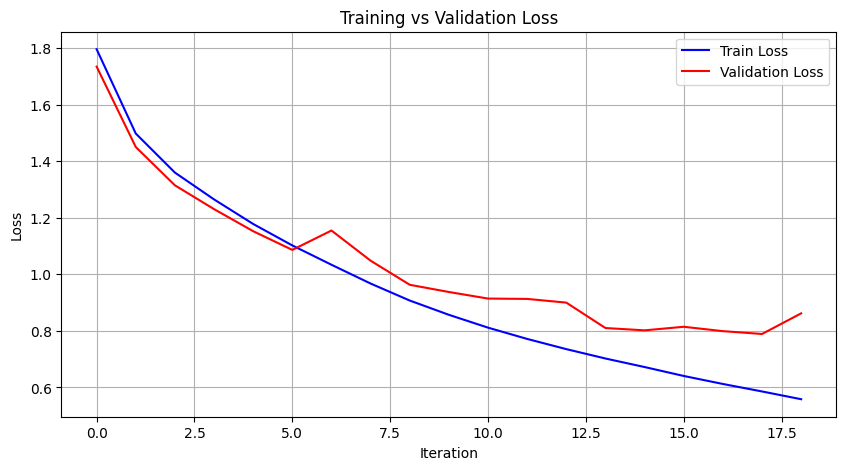

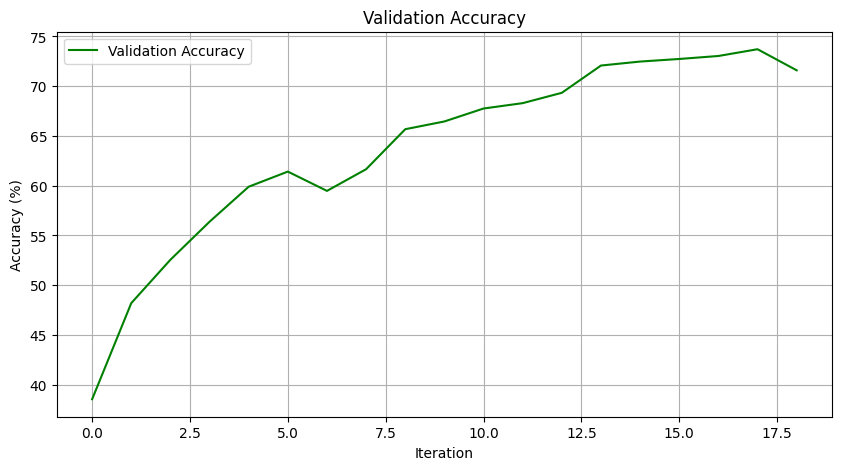

In [5]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.plot(history_loss_train, label='Train Loss', color ='blue')
plt.plot(history_loss_val, label='Validation Loss', color='red')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Training vs Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(history_accuracy_val, label='Validation Accuracy', color='green')
plt.xlabel('Iteration')
plt.ylabel('Accuracy (%)')
plt.title('Validation Accuracy')
plt.legend()
plt.grid(True)
plt.show()

## 5 - Test accuracy on the test set from the iteration where the validation accuracy is maximum

In [6]:
# Model assessment
neural_net.eval()
test_correct = 0
test_total = 0

for test_data in testloader:
    features_test, targets_test = test_data[0].to(device), test_data[1].to(device)
    outputs_test = neural_net(features_test)
    _, predictions_test = torch.max(outputs_test, 1)
    test_total += targets_test.size(0)
    test_correct += (predictions_test == targets_test).sum().item()

# Display test set accuracy
accuracy_test_final = test_correct / test_total
print(f'Test Set Accuracy: {100*accuracy_test_final:.2f}%')

Test Set Accuracy: 71.50%


## 6.1 - 5x5 Kernel Size implementation

### 6.1.1 - Implement a shallow CNN 5x5

In [7]:

class ShallowCNN_5x5(nn.Module):
    def __init__(self):
        super(ShallowCNN_5x5, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=5)
        self.relu1 = nn.ReLU()

        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=5)
        self.relu2 = nn.ReLU()

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=5)
        self.relu3 = nn.ReLU()

        self.conv4 = nn.Conv2d(in_channels=64, out_channels=64, kernel_size=5)
        self.relu4 = nn.ReLU()

        self.flatten = nn.Flatten()
        self.fc = nn.Linear(64 * 4 * 4, 10)  

    def forward(self, x):

        x = self.relu1(self.conv1(x))
        x = self.relu2(self.conv2(x))
        x = self.pool(x)
        x = self.relu3(self.conv3(x))
        x = self.relu4(self.conv4(x))
        x = self.flatten(x)
        x = self.fc(x)

        return x

### 6.1.2 Training, validation and test for 5x5 Kernels

In [8]:
# Initialize the model
model = ShallowCNN_5x5().to(device)
print(next(model.parameters()).device)

# Configuring the model
neural_net = ShallowCNN_5x5().to(device)

# Set up loss calculation and model optimization
loss_function = nn.CrossEntropyLoss()
sgd_optimizer = optim.SGD(neural_net.parameters(), lr=0.002)

# Parameters for training
epochs = 58
eval_step = 3
accumulated_loss = 0.0

# Data structures for recording metrics
history_loss_train = []
history_loss_val = []
history_accuracy_val = []

# Trackers for the best model performance
highest_val_accuracy = 0.0
accuracy_test_best_val = 0.0

# Loop for model training
for epoch_index in range(epochs):
    accumulated_loss = 0.0

    for i, (features, targets) in enumerate(trainloader):
        features, targets = features.to(device), targets.to(device)

        sgd_optimizer.zero_grad()

        predictions = neural_net(features)
        error = loss_function(predictions, targets)
        error.backward()
        sgd_optimizer.step()

        accumulated_loss += error.item()

    # Validate and report at specified intervals
    if (epoch_index + 1) % eval_step == 0:
        neural_net.eval()
        loss_val = 0.0
        correct_preds = 0
        total_preds = 0

        for batch in valloader:
            features_val, targets_val = batch[0].to(device), batch[1].to(device)
            outputs_val = neural_net(features_val)
            loss_val += loss_function(outputs_val, targets_val).item()

            _, predictions_val = torch.max(outputs_val, 1)
            total_preds += targets_val.size(0)
            correct_preds += (predictions_val == targets_val).sum().item()

        accuracy_val = correct_preds / total_preds

        if accuracy_val > highest_val_accuracy:
            highest_val_accuracy = accuracy_val
            
            correct_test = 0
            total_test = 0
            for test_batch in testloader:
                features_test, targets_test = test_batch[0].to(device), test_batch[1].to(device)
                outputs_test = neural_net(features_test)
                _, predictions_test = torch.max(outputs_test, 1)
                total_test += targets_test.size(0)
                correct_test += (predictions_test == targets_test).sum().item()
            accuracy_test_best_val = correct_test / total_test

        # Logging the performance
        print(f'Index [{epoch_index + 1} of {epochs}], '
              f'Train Loss: {accumulated_loss / len(trainloader):.4f}, '
              f'Validation Loss: {loss_val / len(valloader):.4f}, '
              f'and Accuracy: {100 * accuracy_val:.2f}%')

        # Append metrics to lists
        history_loss_train.append(accumulated_loss / len(trainloader))
        history_loss_val.append(loss_val / len(valloader))
        history_accuracy_val.append(100 * accuracy_val)

        # Reset loss for next epoch
        accumulated_loss = 0.0
        neural_net.train()
    
    else:
        print(f'Index [{epoch_index + 1} of {epochs}], '
            f'Train Loss: {accumulated_loss / len(trainloader):.4f}')

print('Done training')

mps:0
Index [1 of 58], Train Loss: 2.2358
Index [2 of 58], Train Loss: 1.9479
Index [3 of 58], Train Loss: 1.7995, Validation Loss: 1.7225, and Accuracy: 36.08%
Index [4 of 58], Train Loss: 1.7035
Index [5 of 58], Train Loss: 1.6172
Index [6 of 58], Train Loss: 1.5479, Validation Loss: 1.5458, and Accuracy: 43.52%
Index [7 of 58], Train Loss: 1.4919
Index [8 of 58], Train Loss: 1.4451
Index [9 of 58], Train Loss: 1.3984, Validation Loss: 1.3471, and Accuracy: 51.40%
Index [10 of 58], Train Loss: 1.3555
Index [11 of 58], Train Loss: 1.3135
Index [12 of 58], Train Loss: 1.2752, Validation Loss: 1.3417, and Accuracy: 52.14%
Index [13 of 58], Train Loss: 1.2338
Index [14 of 58], Train Loss: 1.1942
Index [15 of 58], Train Loss: 1.1614, Validation Loss: 1.1749, and Accuracy: 57.40%
Index [16 of 58], Train Loss: 1.1284
Index [17 of 58], Train Loss: 1.1000
Index [18 of 58], Train Loss: 1.0711, Validation Loss: 1.0862, and Accuracy: 61.26%
Index [19 of 58], Train Loss: 1.0459
Index [20 of 58], 

### 6.1.3 - Plot the training loss, validation loss, and validation accuracy for 5x5 Kernels

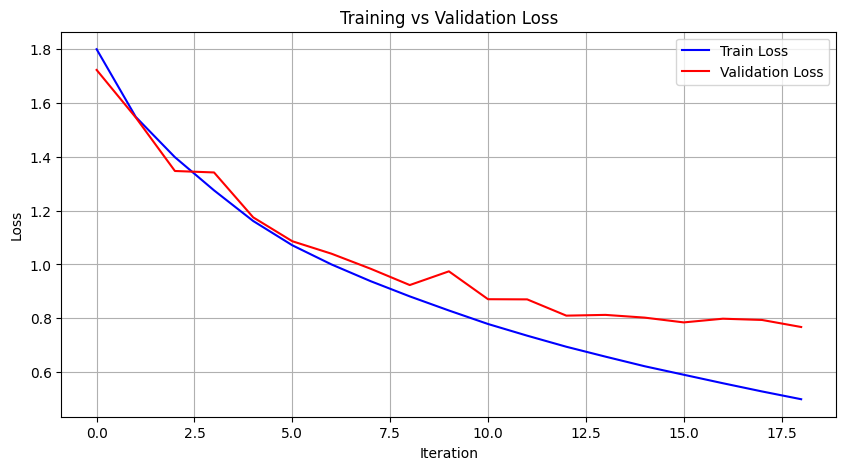

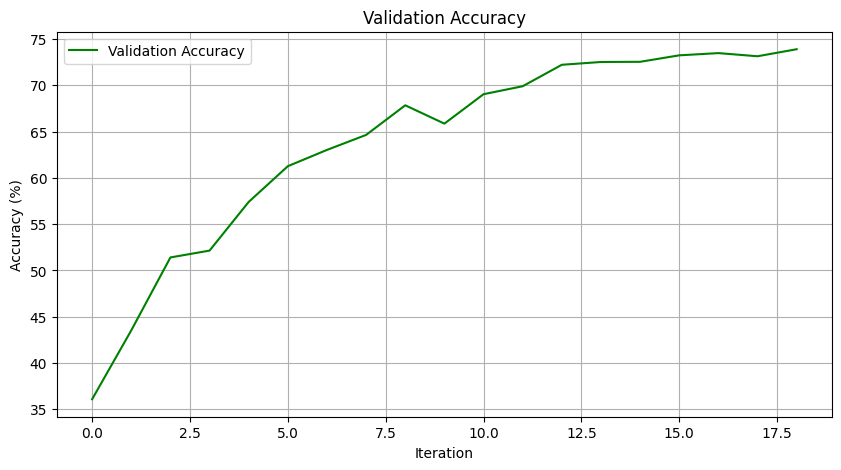

In [9]:
plt.figure(figsize=(10, 5))
plt.plot(history_loss_train, label='Train Loss', color ='blue')
plt.plot(history_loss_val, label='Validation Loss', color='red')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('Training vs Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(history_accuracy_val, label='Validation Accuracy', color='green')
plt.xlabel('Iteration')
plt.ylabel('Accuracy (%)')
plt.title('Validation Accuracy')
plt.legend()
plt.grid(True)
plt.show()

### 6.1.4 - Test accuracy on the test set from the iteration where the validation accuracy is maximum for 5x5 Kernels

In [10]:
# Model assessment
neural_net.eval()
test_correct = 0
test_total = 0

for test_data in testloader:
    features_test, targets_test = test_data[0].to(device), test_data[1].to(device)
    outputs_test = neural_net(features_test)
    _, predictions_test = torch.max(outputs_test, 1)
    test_total += targets_test.size(0)
    test_correct += (predictions_test == targets_test).sum().item()

# Display test set accuracy
accuracy_test_final = test_correct / test_total
print(f'Test Set Accuracy: {100*accuracy_test_final:.2f}%')

Test Set Accuracy: 72.56%


## 6.2 - Comparison of 3x3 and 5x5 Kernels

**3x3 Kernel:**

Runtime: 7 min 2.7 s
Accuracy: 71.5 %

**5x5 Kernel:**

Runtime: 8 min 44.8 s
Accuracy: 72.56 %

Runtime comparison: The runtime of each is mostly similar, even though the 5x5 kernel is a minute and a half longer, it's still not so significant. 

Accuracy comparison: The accuracy is a bit better, which might explain the longer runtime. This might suggest that the larger kernel size might help capture more features, which may explain the better performance. 

Factors Influencing CNN Performance:

1. **Kernel Size**: Acts as the lens through which the model views data, with larger kernels capturing broader patterns and smaller ones highlighting detailed features. This choice directly affects the granularity of information the network perceives.

2. **Model Architecture**: The blueprint of the CNN, including the quantity of layers and their arrangement, dictates the network's learning capacity and ability to generalize from data. Variations here can significantly alter model effectiveness.

3. **Data Complexity and Diversity**: The nature of the dataset itself—how intricate and varied it is—plays a crucial role in determining model success. Datasets with higher complexity and variability often demand tailored architectural or kernel adjustments for best results.

4. **Regularization and Optimization Strategies**: Tools like dropout, batch normalization, and weight regularization are essential for combating overfitting, enhancing the model's ability to generalize. Additionally, the selection of optimization algorithms and learning rate strategies can majorly impact the efficiency of model training and its eventual accuracy.

5. **Randomness in Training Process**: The inherent unpredictability in initial weight assignments and batch-wise data processing introduces variability in model outcomes, even with identical network structures. This randomness underscores the importance of reproducibility measures in CNN experimentation.


## 7 - Deep network ResNet18 implementation

In [11]:
from torchvision.models import resnet18

transform = transforms.Compose(
    [transforms.Resize(224),
     transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)

trainset, temp = torch.utils.data.random_split(trainset, [50000, 0])

valset, testset = torch.utils.data.random_split(testset, [5000, 5000])

trainloader = torch.utils.data.DataLoader(trainset, batch_size=32, shuffle=True)
valloader = torch.utils.data.DataLoader(valset, batch_size=32, shuffle=False)
testloader = torch.utils.data.DataLoader(testset, batch_size=32, shuffle=False)

Files already downloaded and verified
Files already downloaded and verified


### 7.1 - Pre-trained model

In [12]:

# Define the ResNet18 model with modifications for CIFAR-10
class ResNetCIFAR(nn.Module):
    def __init__(self):
        super(ResNetCIFAR, self).__init__()
        self.resnet = resnet18(pretrained=True)
        self.resnet.fc = nn.Linear(512, 10)  # Modify output layer to have 10 classes for CIFAR-10

    def forward(self, x):
        return self.resnet(x)


# Initialize the CIFAR-10 model, loss function, and optimizer
cifar_model = ResNetCIFAR().to(device)
loss_function = nn.CrossEntropyLoss()
sgd_optimizer = optim.SGD(cifar_model.parameters(), lr=0.02)

# Training parameters
epochs = 5
eval_step = 500  # Print loss every 500 batches
accumulated_loss = 0.0

# Best model tracking
best_val_accuracy = 0.0

# Training loop
for epoch_index in range(epochs):
    cifar_model.train()
    accumulated_loss = 0.0

    for batch_index, (inputs, labels) in enumerate(trainloader):
        inputs, labels = inputs.to(device), labels.to(device)

        sgd_optimizer.zero_grad()

        predictions = cifar_model(inputs)
        error = loss_function(predictions, labels)
        error.backward()
        sgd_optimizer.step()

        accumulated_loss += error.item()

        if (batch_index + 1) % eval_step == 0:
            print(f'Epoch [{epoch_index + 1}, {batch_index + 1}], '
                  f'Loss: {accumulated_loss / eval_step:.3f}')
            accumulated_loss = 0.0

    # Validation after each epoch
    cifar_model.eval()
    correct_preds = 0
    total_preds = 0

    with torch.no_grad():
        for inputs, labels in valloader:
            inputs, labels = inputs.to(device), labels.to(device)
            predictions = cifar_model(inputs)
            _, predicted = torch.max(predictions.data, 1)
            total_preds += labels.size(0)
            correct_preds += (predicted == labels).sum().item()

    accuracy_val = 100 * correct_preds / total_preds
    print(f'Validation - Epoch: {epoch_index + 1}, '
          f'Accuracy: {accuracy_val:.2f}%')

    if accuracy_val > best_val_accuracy:
        best_val_accuracy = accuracy_val
        torch.save(cifar_model.state_dict(), 'resnet18_cifar10_best.pth')

# Load the best model based on validation accuracy
cifar_model.load_state_dict(torch.load('resnet18_cifar10_best.pth'))

print('Done training')

/opt/homebrew/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/homebrew/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch [1, 500], Loss: 0.519
Epoch [1, 1000], Loss: 0.297
Epoch [1, 1500], Loss: 0.246
Validation - Epoch: 1, Accuracy: 91.80%
Epoch [2, 500], Loss: 0.131
Epoch [2, 1000], Loss: 0.135
Epoch [2, 1500], Loss: 0.134
Validation - Epoch: 2, Accuracy: 93.52%
Epoch [3, 500], Loss: 0.066
Epoch [3, 1000], Loss: 0.063
Epoch [3, 1500], Loss: 0.072
Validation - Epoch: 3, Accuracy: 94.30%
Epoch [4, 500], Loss: 0.038
Epoch [4, 1000], Loss: 0.034
Epoch [4, 1500], Loss: 0.038
Validation - Epoch: 4, Accuracy: 94.92%
Epoch [5, 500], Loss: 0.024
Epoch [5, 1000], Loss: 0.022
Epoch [5, 1500], Loss: 0.024
Validation - Epoch: 5, Accuracy: 94.80%
Done training


In [13]:
# Test the model
cifar_model.eval()
correct_test = 0
total_test = 0

with torch.no_grad():
    for inputs, labels in testloader:
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = cifar_model(inputs)
        _, predicted = torch.max(predictions.data, 1)
        total_test += labels.size(0)
        correct_test += (predicted == labels).sum().item()

test_accuracy = 100 * correct_test / total_test
print(f'Test Accuracy: {test_accuracy:.2f}%')

Test Accuracy: 95.16%


### 7.2 - Not trained model

In [14]:

# Define the ResNet18 model with modifications for CIFAR-10
class ResNetCIFAR(nn.Module):
    def __init__(self):
        super(ResNetCIFAR, self).__init__()
        self.resnet = resnet18(pretrained=False)
        self.resnet.fc = nn.Linear(512, 10)  # Modify output layer to have 10 classes for CIFAR-10

    def forward(self, x):
        return self.resnet(x)

# Check if Apple Silicon GPU is available
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Initialize the model
model = ShallowCNN().to(device)
print("The device will use:", next(model.parameters()).device)

# Initialize the CIFAR-10 model, loss function, and optimizer
cifar_model = ResNetCIFAR().to(device)
loss_function = nn.CrossEntropyLoss()
sgd_optimizer = optim.SGD(cifar_model.parameters(), lr=0.02)

# Training parameters
epochs = 5
eval_step = 500  # Print loss every 500 batches
accumulated_loss = 0.0

# Best model tracking
best_val_accuracy = 0.0

# Training loop
for epoch_index in range(epochs):
    cifar_model.train()
    accumulated_loss = 0.0

    for batch_index, (inputs, labels) in enumerate(trainloader):
        inputs, labels = inputs.to(device), labels.to(device)

        sgd_optimizer.zero_grad()

        predictions = cifar_model(inputs)
        error = loss_function(predictions, labels)
        error.backward()
        sgd_optimizer.step()

        accumulated_loss += error.item()

        if (batch_index + 1) % eval_step == 0:
            print(f'Epoch [{epoch_index + 1}, {batch_index + 1}], '
                  f'Loss: {accumulated_loss / eval_step:.3f}')
            accumulated_loss = 0.0

    # Validation after each epoch
    cifar_model.eval()
    correct_preds = 0
    total_preds = 0

    with torch.no_grad():
        for inputs, labels in valloader:
            inputs, labels = inputs.to(device), labels.to(device)
            predictions = cifar_model(inputs)
            _, predicted = torch.max(predictions.data, 1)
            total_preds += labels.size(0)
            correct_preds += (predicted == labels).sum().item()

    accuracy_val = 100 * correct_preds / total_preds
    print(f'Validation - Epoch: {epoch_index + 1}, '
          f'Accuracy: {accuracy_val:.2f}%')

    if accuracy_val > best_val_accuracy:
        best_val_accuracy = accuracy_val
        torch.save(cifar_model.state_dict(), 'resnet18_cifar10_best.pth')

# Load the best model based on validation accuracy
cifar_model.load_state_dict(torch.load('resnet18_cifar10_best.pth'))

print('Done')

The device will use: mps:0


/opt/homebrew/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Epoch [1, 500], Loss: 1.803
Epoch [1, 1000], Loss: 1.463
Epoch [1, 1500], Loss: 1.291
Validation - Epoch: 1, Accuracy: 39.04%
Epoch [2, 500], Loss: 1.126
Epoch [2, 1000], Loss: 1.031
Epoch [2, 1500], Loss: 0.970
Validation - Epoch: 2, Accuracy: 64.78%
Epoch [3, 500], Loss: 0.839
Epoch [3, 1000], Loss: 0.786
Epoch [3, 1500], Loss: 0.767
Validation - Epoch: 3, Accuracy: 67.08%
Epoch [4, 500], Loss: 0.636
Epoch [4, 1000], Loss: 0.618
Epoch [4, 1500], Loss: 0.612
Validation - Epoch: 4, Accuracy: 70.50%
Epoch [5, 500], Loss: 0.467
Epoch [5, 1000], Loss: 0.491
Epoch [5, 1500], Loss: 0.491
Validation - Epoch: 5, Accuracy: 68.90%
Done


In [16]:
# Test the model
cifar_model.eval()
correct_test = 0
total_test = 0

with torch.no_grad():
    for inputs, labels in testloader:
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = cifar_model(inputs)
        _, predicted = torch.max(predictions.data, 1)
        total_test += labels.size(0)
        correct_test += (predicted == labels).sum().item()

test_accuracy = 100 * correct_test / total_test
print(f'Test Accuracy: {test_accuracy:.2f}%')

Test Accuracy: 69.68%


### 7.3 - Comparison between pre-trained and not trained

**Pre-Trained:**

Runtime: 19 min 37.1 s
Accuracy: 95.16 %

**Not trained:**

Runtime: 19 min 43.7 s
Accuracy: 69.68 %

Runtime comparison: The runtime of each is mostly similar. 

Accuracy comparison: The accuracy is a way better with the pre-trained, which might explain the longer runtime. This might suggest that the larger kernel size might help capture more features, which may explain the better performance. 

Opting for a pre-trained ResNet18 offers advantages like quicker convergence, better generalization with sparse data, and lower data demands for training, but it may struggle with discrepancies between different domains and a larger model size. Conversely, training a model from the ground up is beneficial when there's a substantial difference between the target and source domains, as it enhances domain adaptation and allows for more customization. This approach, though, demands more data and computational power, and tends to converge more slowly.

### 7.4 - Comparison between ResNet18 and Shallow CNN

From my test, both the basic CNN and the untrained ResNet18 model demonstrated similar performance, each securing a test accuracy of around 72%. This suggests that they are similarly capable in terms of performance. However, the deep ResNet18 model, when pre-trained, stands out by reaching a significantly higher test accuracy of 95%. This underlines the value of transfer learning, where utilizing pre-existing weights from a comprehensive dataset markedly enhances performance. It enables the model to capture more complex feature representations and better adapt to the specific task at hand.

# Part 2 - YOLOv8 Object Detection on Montréal Streets

Ultralytics YOLOv8.1.28 🚀 Python-3.11.7 torch-2.2.0 CPU (Apple M3 Pro)
Setup complete ✅ (12 CPUs, 18.0 GB RAM, 171.7/926.4 GB disk)


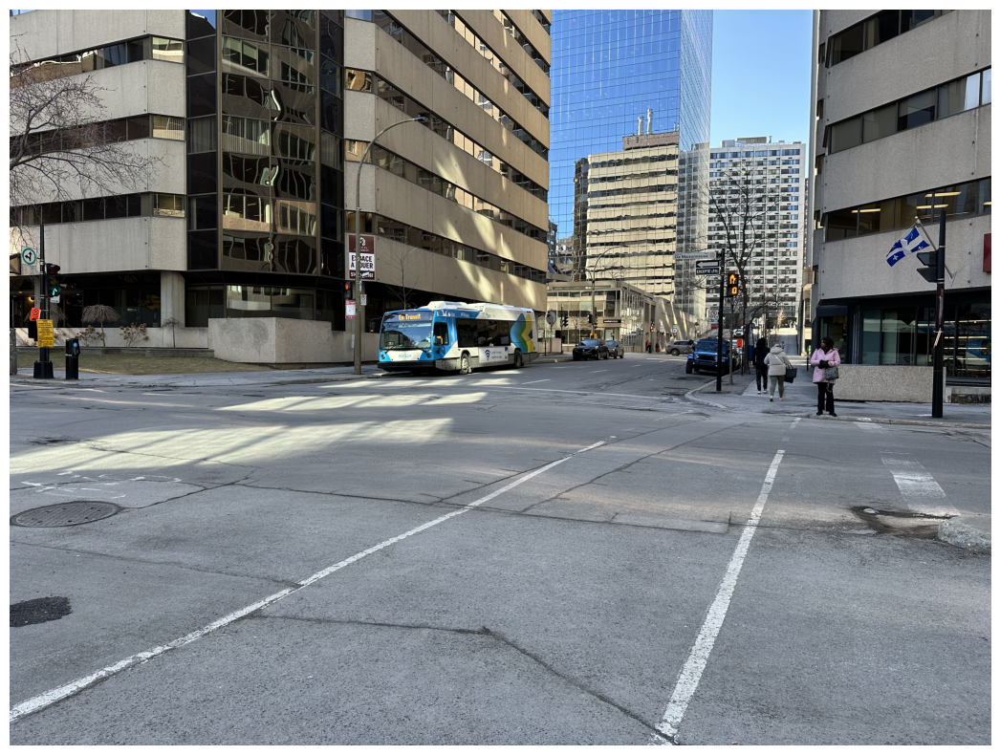


0: 480x640 4 persons, 5 cars, 1 bus, 4 traffic lights, 1 fire hydrant, 62.8ms
Speed: 2.5ms preprocess, 62.8ms inference, 0.6ms postprocess per image at shape (1, 3, 480, 640)


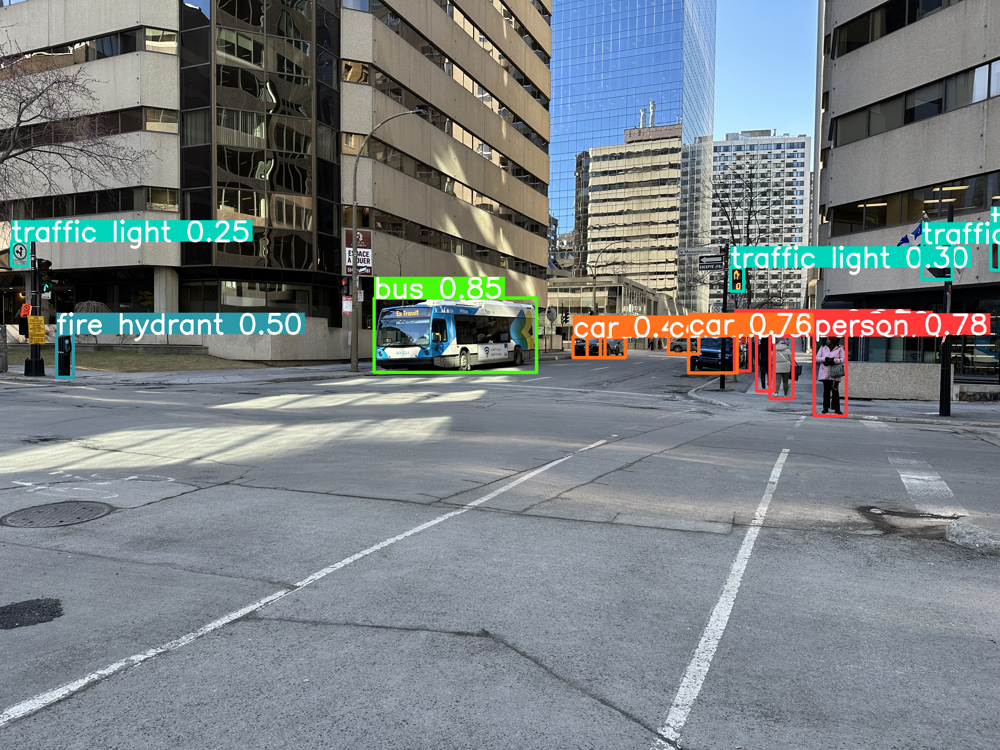

In [15]:
import ultralytics
ultralytics.checks()
import cv2
from PIL import Image
from ultralytics import YOLO
from matplotlib import pyplot as plt

path = '/Users/karl/Documents/Workspace/415/Assignment 4/'
img = cv2.imread(path + 'mtl_street.png')

image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 10))
plt.imshow(image_rgb)
plt.axis('off')


plt.show()

model = YOLO('yolov8s.pt')
results = model.predict(img)
result = results[0]

Image.fromarray(result.plot()[:,:,::-1])